# PLEASE CLONE THIS NOTEBOOK INTO YOUR PERSONAL FOLDER

In [0]:
from pyspark.sql.functions import col
print("Welcome to the W261 final project!") 

Welcome to the W261 final project!



# Know your mount
Here is the mounting for this class, your source for the original data! Remember, you only have Read access, not Write! Also, become familiar with `dbutils` the equivalent of `gcp` in DataProc

In [0]:
data_BASE_DIR = "dbfs:/mnt/mids-w261/"
display(dbutils.fs.ls(f"{data_BASE_DIR}"))

path,name,size,modificationTime
dbfs:/mnt/mids-w261/HW5/,HW5/,0,1761773119955
dbfs:/mnt/mids-w261/OTPW_12M/,OTPW_12M/,0,1761773119955
dbfs:/mnt/mids-w261/OTPW_1D_CSV/,OTPW_1D_CSV/,0,1761773119956
dbfs:/mnt/mids-w261/OTPW_36M/,OTPW_36M/,0,1761773119956
dbfs:/mnt/mids-w261/OTPW_3M/,OTPW_3M/,0,1761773119956
dbfs:/mnt/mids-w261/OTPW_3M_2015.csv,OTPW_3M_2015.csv,1500620247,1741625185000
dbfs:/mnt/mids-w261/OTPW_3M_2015_delta/,OTPW_3M_2015_delta/,0,1761773119956
dbfs:/mnt/mids-w261/OTPW_60M/,OTPW_60M/,0,1761773119956
dbfs:/mnt/mids-w261/OTPW_60M_Backup/,OTPW_60M_Backup/,0,1761773119956
dbfs:/mnt/mids-w261/airport-codes_csv.csv,airport-codes_csv.csv,6232459,1740508595000


In [0]:
dbutils.fs.help()

dbutils.fs provides utilities for working with FileSystems. Most methods in
this package can take either a DBFS path (e.g., "/foo" or "dbfs:/foo"), or
another FileSystem URI.

For more info about a method, use dbutils.fs.help("methodName") .

In notebooks, you can also use the %fs shorthand to access DBFS. The %fs shorthand maps
straightforwardly onto dbutils calls. For example, "%fs head --maxBytes=10000 /file/path"
translates into "dbutils.fs.head("/file/path", maxBytes = 10000)".
 mount mount(source: String, mountPoint: String, encryptionType: String = "", owner: String = null, extraConfigs: Map = Map.empty[String, String]): boolean -> Mounts the given source directory into DBFS at the given mount point mounts: Seq -> Displays information about what is mounted within DBFS refreshMounts: boolean -> Forces all machines in this cluster to refresh their mount cache, ensuring they receive the most recent information unmount(mountPoint: String): boolean -> Deletes a DBFS mount point updateMount(source: String, mountPoint: String, encryptionType: String = "", owner: String = null, extraConfigs: Map = Map.empty[String, String]): boolean -> Similar to mount(), but updates an existing mount point (if present) instead of creating a new one fsutils cp(from: String, to: String, recurse: boolean = false): boolean -> Copies a file or directory, possibly across FileSystems head(file: String, maxBytes: int = 65536): String -> Returns up to the first 'maxBytes' bytes of the given file as a String encoded in UTF-8 ls(dir: String): Seq -> Lists the contents of a directory mkdirs(dir: String): boolean -> Creates the given directory if it does not exist, also creating any necessary parent directories mv(from: String, to: String, recurse: boolean = false): boolean -> Moves a file or directory, possibly across FileSystems put(file: String, contents: String, overwrite: boolean = false): boolean -> Writes the given String out to a file, encoded in UTF-8 rm(dir: String, recurse: boolean = false): boolean -> Removes a file or directory

# Data for the Project

For the project you will have 4 sources of data:

1. Airlines Data: This is the raw data of flights information. You have 3 months, 6 months, 1 year, and full data from 2015 to 2019. Remember the maxima: "Test, Test, Test", so a lot of testing in smaller samples before scaling up! Location of the data? `dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data/`, `dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_1y/`, etc. (Below the dbutils to get the folders)
2. Weather Data: Raw data for weather information. Same as before, we are sharing 3 months, 6 months, 1 year
3. Stations data: Extra information of the location of the different weather stations. Location `dbfs:/mnt/mids-w261/datasets_final_project_2022/datasets_final_project_2022/stations_data/stations_with_neighbors.parquet/`
4. OTPW Data: This is our joined data (We joined Airlines and Weather). This is the main dataset for your project, the previous 3 are given for reference. You can attempt your own join for Extra Credit. Location `dbfs:/mnt/mids-w261/OTPW_60M/OTPW_60M/` and more, several samples are given!

In [0]:
# Airline Data    
df_flights = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_3m/")
display(df_flights)

QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,DIV_AIRPORT_LANDINGS,DIV_REACHED_DEST,DIV_ACTUAL_ELAPSED_TIME,DIV_ARR_DELAY,DIV_DISTANCE,DIV1_AIRPORT,DIV1_AIRPORT_ID,DIV1_AIRPORT_SEQ_ID,DIV1_WHEELS_ON,DIV1_TOTAL_GTIME,DIV1_LONGEST_GTIME,DIV1_WHEELS_OFF,DIV1_TAIL_NUM,DIV2_AIRPORT,DIV2_AIRPORT_ID,DIV2_AIRPORT_SEQ_ID,DIV2_WHEELS_ON,DIV2_TOTAL_GTIME,DIV2_LONGEST_GTIME,DIV2_WHEELS_OFF,DIV2_TAIL_NUM,DIV3_AIRPORT,DIV3_AIRPORT_ID,DIV3_AIRPORT_SEQ_ID,DIV3_WHEELS_ON,DIV3_TOTAL_GTIME,DIV3_LONGEST_GTIME,DIV3_WHEELS_OFF,DIV3_TAIL_NUM,DIV4_AIRPORT,DIV4_AIRPORT_ID,DIV4_AIRPORT_SEQ_ID,DIV4_WHEELS_ON,DIV4_TOTAL_GTIME,DIV4_LONGEST_GTIME,DIV4_WHEELS_OFF,DIV4_TAIL_NUM,DIV5_AIRPORT,DIV5_AIRPORT_ID,DIV5_AIRPORT_SEQ_ID,DIV5_WHEELS_ON,DIV5_TOTAL_GTIME,DIV5_LONGEST_GTIME,DIV5_WHEELS_OFF,DIV5_TAIL_NUM,YEAR
1,2,19,4,2015-02-19,AA,19805,AA,N520AA,323,15016,1501603,31123,STL,"St. Louis, MO",MO,29,Missouri,64,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,901,949,48.0,48.0,1.0,3,0900-0959,23.0,1012,1130,5.0,1058,1135,37.0,37.0,1.0,2,1000-1059,0.0,null,0.0,117.0,106.0,78.0,1.0,550.0,3,0.0,5.0,0.0,0.0,32.0,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,20,5,2015-02-20,AA,19805,AA,N4XUAA,323,15016,1501603,31123,STL,"St. Louis, MO",MO,29,Missouri,64,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,901,855,-6.0,0.0,0.0,-1,0900-0959,11.0,906,1033,26.0,1058,1059,1.0,1.0,0.0,0,1000-1059,0.0,null,0.0,117.0,124.0,87.0,1.0,550.0,3,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,21,6,2015-02-21,AA,19805,AA,N486AA,323,15016,1501603,31123,STL,"St. Louis, MO",MO,29,Missouri,64,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,901,1018,77.0,77.0,1.0,5,0900-0959,11.0,1029,1207,5.0,1058,1212,74.0,74.0,1.0,4,1000-1059,0.0,null,0.0,117.0,114.0,98.0,1.0,550.0,3,27.0,0.0,0.0,0.0,47.0,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,22,7,2015-02-22,AA,19805,AA,N456AA,323,15016,1501603,31123,STL,"St. Louis, MO",MO,29,Missouri,64,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,901,853,-8.0,0.0,0.0,-1,0900-0959,9.0,902,1036,14.0,1058,1050,-8.0,0.0,0.0,-1,1000-1059,0.0,null,0.0,117.0,117.0,94.0,1.0,550.0,3,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,23,1,2015-02-23,AA,19805,AA,N4XTAA,323,15016,1501603,31123,STL,"St. Louis, MO",MO,29,Missouri,64,11298,1129803,30194,DFW,"Dallas/Fort Worth, TX",TX,48,Texas,74,901,n

In [0]:
# Weather data
df_weather = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_3m/")
display(df_weather)

STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitationValue120,ShortDurationPrecipitationValue150,ShortDurationPrecipitationValue180,REM,BackupDirection,BackupDistance,BackupDistanceUnit,BackupElements,BackupElevation,BackupEquipment,BackupLatitude,BackupLongitude,BackupName,WindEquipmentChangeDate,YEAR
52652099999,2015-01-01T02:00:00,39.0833333,100.2833333,1462.0,"ZHANGYE, CH",FM-12,4,null,-1,3,null,null,+0.04,7,83,null,30.72,25.45,null,2,290,null,4,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,SYN06452652 32/// 92902 11163 21186 38618 40403 57015 333 00051 11045=,null,null,null,null,null,null,null,null,null,null,2015
52652099999,2015-01-01T05:00:00,39.0833333,100.2833333,1462.0,"ZHANGYE, CH",FM-12,4,null,-1,4,null,null,+0.01,7,77,null,30.68,null,null,null,320,null,4,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,nul

In [0]:
# Stations data      
df_stations = spark.read.parquet(f"dbfs:/mnt/mids-w261/datasets_final_project_2022/stations_data/stations_with_neighbors.parquet/")
display(df_stations)

usaf,wban,station_id,lat,lon,neighbor_id,neighbor_name,neighbor_state,neighbor_call,neighbor_lat,neighbor_lon,distance_to_neighbor
690020,93218,69002093218,36.0,-121.233,69002093218,JOLON HUNTER LIGGETT MIL RES,CA,KHGT,36.0,-121.233,0.0
690020,93218,69002093218,36.0,-121.233,69007093217,FRITZSCHE AAF,CA,KOAR,36.683,-121.767,55.73024537916726
690020,93218,69002093218,36.0,-121.233,69014093101,EL TORO MCAS,CA,KNZJ,33.667,-117.733,255.49106220353934
690020,93218,69002093218,36.0,-121.233,70027127506,BARROW POINT BARROW,AK,KPBA,71.333,-156.65,2750.4353299559803
690020,93218,69002093218,36.0,-121.233,70045027512,LONELY,AK,LNI,70.917,-153.25,2676.3554370627153
690020,93218,69002093218,36.0,-121.233,70063027403,OLIKTOK POW 2,AK,POLI,70.5,-149.883,2604.050248854232
690020,93218,69002093218,36.0,-121.233,70063526465,GALBRAITH LAKE AIRPORT,AK,PAGB,68.479,-149.49,2490.9756094472277
690020,93218,69002093218,36.0,-121.233,70063627405,PRUDHOE BAY,AK,PAUD,70.25,-148.333,2568.180281844432
690020,93218,69002093218,36.0,-121.233,70104626418,CENTRAL AIRPORT,AK,PACE,65.567,-144.765,2254.5584891291946
690020,93218,69002093218,36.0,-121.233,70119526625,SHISHMAREF/NEW AIRPORT,AK,PASH,66.25,-166.089,2743.6881828292408


In [0]:
# OTPW
df_otpw = spark.read.format("csv").option("header","true").load(f"dbfs:/mnt/mids-w261/OTPW_3M_2015.csv")
display(df_otpw)

QUARTER,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,YEAR,MONTH,origin_airport_name,origin_station_name,origin_station_id,origin_iata_code,origin_icao,origin_type,origin_region,origin_station_lat,origin_station_lon,origin_airport_lat,origin_airport_lon,origin_station_dis,dest_airport_name,dest_station_name,dest_station_id,dest_iata_code,dest_icao,dest_type,dest_region,dest_station_lat,dest_station_lon,dest_airport_lat,dest_airport_lon,dest_station_dis,sched_depart_date_time,sched_depart_date_time_UTC,four_hours_prior_depart_UTC,two_hours_prior_depart_UTC,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitat


# Example of EDA

neighbor_id,avg_distance_to_neighbor
72446453916,937.4120059925416
72445514938,938.1378817093266
72086900295,938.8995895007262
72104500354,938.9102677159071
72445303994,939.550187422034
72236700363,939.5670922339551
72446713930,939.6010023796134
72227454939,939.6353100975778
72549994991,939.8025783384629
72030653879,940.027653255945


OP_UNIQUE_CARRIER,Avg_DEP_DELAY,Avg_ARR_DELAY,Avg_DISTANCE
UA,14.265419187554018,6.086884564060794,1262.106518484687
NK,14.114123679303916,12.452040935444959,990.5975907288807
AA,10.669361093121617,7.033634336856625,1080.5137763745572
EV,9.87544007293639,8.433243639232481,465.4183232497839
B6,14.805093062052272,11.98958812323458,1058.635216684385
DL,8.759463995117983,1.805139284495014,856.4882313719789
OO,9.540316438415221,7.740737265318791,483.6363578818548
F9,20.98568179468624,21.642080182326737,950.5560547273841
US,6.650787297909316,4.393991588646786,894.8638929073535
MQ,15.556966627710686,16.675380439038396,433.1925964276469


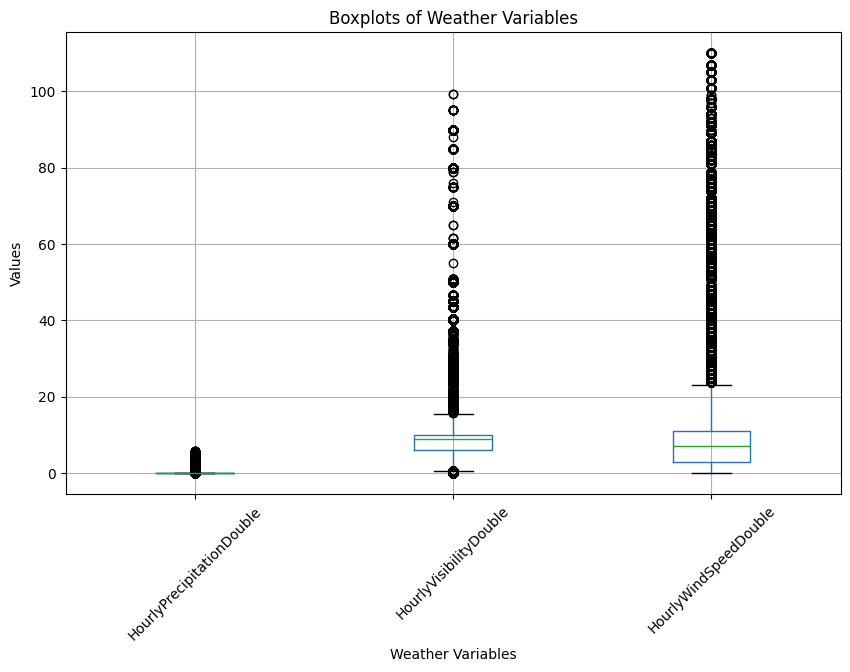

In [0]:
import pyspark.sql.functions as F
import matplotlib.pyplot as plt

df_weather = spark.read.parquet(f"{data_BASE_DIR}/datasets_final_project_2022/parquet_weather_data_3m/")

# Grouping and aggregation for df_stations
grouped_stations = df_stations.groupBy('neighbor_id').agg(
    F.avg('distance_to_neighbor').alias('avg_distance_to_neighbor'),
).orderBy('avg_distance_to_neighbor')

display(grouped_stations)

# Grouping and aggregation for df_flights
grouped_flights = df_flights.groupBy('OP_UNIQUE_CARRIER').agg(
    F.avg('DEP_DELAY').alias('Avg_DEP_DELAY'),
    F.avg('ARR_DELAY').alias('Avg_ARR_DELAY'),
    F.avg('DISTANCE').alias('Avg_DISTANCE')
)

display(grouped_flights)

# Convert columns to appropriate data types
df_weather = df_weather.withColumn("HourlyPrecipitationDouble", F.col("HourlyPrecipitation").cast("double"))
df_weather = df_weather.withColumn("HourlyVisibilityDouble", F.col("HourlyVisibility").cast("double"))
df_weather = df_weather.withColumn("HourlyWindSpeedDouble", F.col("HourlyWindSpeed").cast("double")).filter(F.col("HourlyWindSpeedDouble") < 2000)

# Overlayed boxplots for df_weather
weather_cols = ['HourlyPrecipitationDouble', 'HourlyVisibilityDouble', 'HourlyWindSpeedDouble']
weather_data = df_weather.select(*weather_cols).toPandas()

plt.figure(figsize=(10, 6))
weather_data.boxplot(column=weather_cols)
plt.title('Boxplots of Weather Variables')
plt.xlabel('Weather Variables')
plt.ylabel('Values')
plt.xticks(rotation=45)
plt.show()

## Where to Checkpoint your data?
There is a folder created in the Mount called `student-groups`. Please create a folder there with the name `Group_{section}_{number}` for example, Group Section 01 Number 01 will be `Group_01_01`. Any folder that doesn't follow this convection will be deleted without warning. Thanks! 

In [0]:
# # Create folder
# section = "04"
# number = "01"
# folder_path = f"dbfs:/student-groups/Group_{section}_{number}"
# dbutils.fs.mkdirs(folder_path)

# # Save df_weather as a parquet file
# df_weather.write.parquet(f"{folder_path}/df_weather.parquet")

# Pipeline Steps For Classification Problem

These are the "normal" steps for a Classification Pipeline! Of course, you can try more!

## 1. Data cleaning and preprocessing

* Remove outliers or missing values
* Encode categorical features
* Scale numerical features

## 2. Feature selection

* Select the most important features for the model
* Use univariate feature selection, recursive feature elimination, or random forest feature importance

## 3. Model training

* Train a machine learning model to predict delays more than 15 minutes
* Use logistic regression, decision trees, random forests, or support vector machines

## 4. Model evaluation

* Evaluate the performance of the trained model on a holdout dataset
* Use accuracy, precision, recall, or F1 score

## 5. Model deployment

* Deploy the trained model to a production environment
* Deploy the model as a web service or as a mobile app

## Tools

* Spark's MLlib and SparkML libraries
* These libraries have parallelized methods for data cleaning and preprocessing, feature selection, model training, model evaluation, and model deployment which we will utilize for this classification problem.


#Begin

In [0]:
def quick_analysis(some_df,name):
    print("-",name,"--")
    print(some_df.describe())
    print("cols",len(some_df.columns))
    print("rows",some_df.count())

In [0]:
quick_analysis(df_flights,"flights")
print("-----------------------------")
quick_analysis(df_weather, "weather")
print("-----------------------------")
quick_analysis(df_stations, "stations")
print("-----------------------------")
quick_analysis(df_otpw, "otpw")

- flights --
DataFrame[summary: string, QUARTER: string, MONTH: string, DAY_OF_MONTH: string, DAY_OF_WEEK: string, FL_DATE: string, OP_UNIQUE_CARRIER: string, OP_CARRIER_AIRLINE_ID: string, OP_CARRIER: string, TAIL_NUM: string, OP_CARRIER_FL_NUM: string, ORIGIN_AIRPORT_ID: string, ORIGIN_AIRPORT_SEQ_ID: string, ORIGIN_CITY_MARKET_ID: string, ORIGIN: string, ORIGIN_CITY_NAME: string, ORIGIN_STATE_ABR: string, ORIGIN_STATE_FIPS: string, ORIGIN_STATE_NM: string, ORIGIN_WAC: string, DEST_AIRPORT_ID: string, DEST_AIRPORT_SEQ_ID: string, DEST_CITY_MARKET_ID: string, DEST: string, DEST_CITY_NAME: string, DEST_STATE_ABR: string, DEST_STATE_FIPS: string, DEST_STATE_NM: string, DEST_WAC: string, CRS_DEP_TIME: string, DEP_TIME: string, DEP_DELAY: string, DEP_DELAY_NEW: string, DEP_DEL15: string, DEP_DELAY_GROUP: string, DEP_TIME_BLK: string, TAXI_OUT: string, WHEELS_OFF: string, WHEELS_ON: string, TAXI_IN: string, CRS_ARR_TIME: string, ARR_TIME: string, ARR_DELAY: string, ARR_DELAY_NEW: string, A

In [0]:
sorted(df_flights.columns)

['ACTUAL_ELAPSED_TIME',
 'AIR_TIME',
 'ARR_DEL15',
 'ARR_DELAY',
 'ARR_DELAY_GROUP',
 'ARR_DELAY_NEW',
 'ARR_TIME',
 'ARR_TIME_BLK',
 'CANCELLATION_CODE',
 'CANCELLED',
 'CARRIER_DELAY',
 'CRS_ARR_TIME',
 'CRS_DEP_TIME',
 'CRS_ELAPSED_TIME',
 'DAY_OF_MONTH',
 'DAY_OF_WEEK',
 'DEP_DEL15',
 'DEP_DELAY',
 'DEP_DELAY_GROUP',
 'DEP_DELAY_NEW',
 'DEP_TIME',
 'DEP_TIME_BLK',
 'DEST',
 'DEST_AIRPORT_ID',
 'DEST_AIRPORT_SEQ_ID',
 'DEST_CITY_MARKET_ID',
 'DEST_CITY_NAME',
 'DEST_STATE_ABR',
 'DEST_STATE_FIPS',
 'DEST_STATE_NM',
 'DEST_WAC',
 'DISTANCE',
 'DISTANCE_GROUP',
 'DIV1_AIRPORT',
 'DIV1_AIRPORT_ID',
 'DIV1_AIRPORT_SEQ_ID',
 'DIV1_LONGEST_GTIME',
 'DIV1_TAIL_NUM',
 'DIV1_TOTAL_GTIME',
 'DIV1_WHEELS_OFF',
 'DIV1_WHEELS_ON',
 'DIV2_AIRPORT',
 'DIV2_AIRPORT_ID',
 'DIV2_AIRPORT_SEQ_ID',
 'DIV2_LONGEST_GTIME',
 'DIV2_TAIL_NUM',
 'DIV2_TOTAL_GTIME',
 'DIV2_WHEELS_OFF',
 'DIV2_WHEELS_ON',
 'DIV3_AIRPORT',
 'DIV3_AIRPORT_ID',
 'DIV3_AIRPORT_SEQ_ID',
 'DIV3_LONGEST_GTIME',
 'DIV3_TAIL_NUM',
 'DIV

In [0]:
def check_missing(some_df, name):
    print(name)
    missing_counts = some_df.select([F.count(F.when(F.col(c).isNull(), c)).alias(c) for c in some_df.columns])
    display(missing_counts.toPandas().T.reset_index().rename(columns={'index': 'column', 0: 'missing_count'}))

In [0]:
check_missing(df_flights, "flights")
print("-----------------------------")
check_missing(df_weather, "weather")
print("-----------------------------")
check_missing(df_stations, "stations")
print("-----------------------------")
check_missing(df_otpw, "otpw")

flights


column,missing_count
QUARTER,0
MONTH,0
DAY_OF_MONTH,0
DAY_OF_WEEK,0
FL_DATE,0
OP_UNIQUE_CARRIER,0
OP_CARRIER_AIRLINE_ID,0
OP_CARRIER,0
TAIL_NUM,16380
OP_CARRIER_FL_NUM,0


-----------------------------
weather


column,missing_count
STATION,0
DATE,0
LATITUDE,190414
LONGITUDE,190414
ELEVATION,190414
NAME,190414
REPORT_TYPE,0
SOURCE,0
HourlyAltimeterSetting,10198924
HourlyDewPointTemperature,1600199


-----------------------------
stations


column,missing_count
usaf,0
wban,0
station_id,0
lat,0
lon,0
neighbor_id,0
neighbor_name,0
neighbor_state,0
neighbor_call,0
neighbor_lat,0


-----------------------------
otpw


column,missing_count
QUARTER,0
DAY_OF_MONTH,0
DAY_OF_WEEK,0
FL_DATE,0
OP_UNIQUE_CARRIER,0
OP_CARRIER_AIRLINE_ID,0
OP_CARRIER,0
TAIL_NUM,8187
OP_CARRIER_FL_NUM,0
ORIGIN_AIRPORT_ID,0


In [0]:
def check_duplicates(some_df, name):
    print(name)
    total_rows = some_df.count()
    distinct_rows = some_df.distinct().count()
    duplicate_count = total_rows - distinct_rows
    print(f"Total rows: {total_rows}")
    print(f"Distinct rows: {distinct_rows}")
    print(f"Duplicate rows: {duplicate_count}")
    if duplicate_count > 0:
        print("Duplicates found.")
    else:
        print("No duplicates found.")

In [0]:
check_duplicates(df_flights, "flights")
print("-----------------------------")
check_duplicates(df_weather, "weather")
print("-----------------------------")
check_duplicates(df_stations, "stations")
print("-----------------------------")
check_duplicates(df_otpw, "otpw")

flights
Total rows: 2806942
Distinct rows: 1403471
Duplicate rows: 1403471
Duplicates found.
-----------------------------
weather
Total rows: 26481620
Distinct rows: 26481620
Duplicate rows: 0
No duplicates found.
-----------------------------
stations
Total rows: 5004169
Distinct rows: 5004169
Duplicate rows: 0
No duplicates found.
-----------------------------
otpw
Total rows: 1401363
Distinct rows: 1401363
Duplicate rows: 0
No duplicates found.


Strategy - Get rid of duplicates, then interpolate or impute or delete missing itemed rows irrelevant for us?

In [0]:
# Check for entry errors in df_flights: out-of-range values, and invalid types

entry_error_checks = [
    ("DEP_DELAY", F.col("DEP_DELAY") < -60)  # Departure delay less than -60 minutes
]

for col_name, condition in entry_error_checks:
    print(f"Entry errors in {col_name}:")
    display(df_flights.filter(condition))

Entry errors in DEP_DELAY:


QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,DIV_AIRPORT_LANDINGS,DIV_REACHED_DEST,DIV_ACTUAL_ELAPSED_TIME,DIV_ARR_DELAY,DIV_DISTANCE,DIV1_AIRPORT,DIV1_AIRPORT_ID,DIV1_AIRPORT_SEQ_ID,DIV1_WHEELS_ON,DIV1_TOTAL_GTIME,DIV1_LONGEST_GTIME,DIV1_WHEELS_OFF,DIV1_TAIL_NUM,DIV2_AIRPORT,DIV2_AIRPORT_ID,DIV2_AIRPORT_SEQ_ID,DIV2_WHEELS_ON,DIV2_TOTAL_GTIME,DIV2_LONGEST_GTIME,DIV2_WHEELS_OFF,DIV2_TAIL_NUM,DIV3_AIRPORT,DIV3_AIRPORT_ID,DIV3_AIRPORT_SEQ_ID,DIV3_WHEELS_ON,DIV3_TOTAL_GTIME,DIV3_LONGEST_GTIME,DIV3_WHEELS_OFF,DIV3_TAIL_NUM,DIV4_AIRPORT,DIV4_AIRPORT_ID,DIV4_AIRPORT_SEQ_ID,DIV4_WHEELS_ON,DIV4_TOTAL_GTIME,DIV4_LONGEST_GTIME,DIV4_WHEELS_OFF,DIV4_TAIL_NUM,DIV5_AIRPORT,DIV5_AIRPORT_ID,DIV5_AIRPORT_SEQ_ID,DIV5_WHEELS_ON,DIV5_TOTAL_GTIME,DIV5_LONGEST_GTIME,DIV5_WHEELS_OFF,DIV5_TAIL_NUM,YEAR
1,2,16,1,2015-02-16,DL,19790,DL,N301DQ,1210,12217,1221702,30255,HSV,"Huntsville, AL",AL,1,Alabama,51,10397,1039705,30397,ATL,"Atlanta, GA",GA,13,Georgia,34,700,559,-61.0,0.0,0.0,-2,0700-0759,15.0,614,743,5.0,905,748,-77.0,0.0,0.0,-2,0900-0959,0.0,null,0.0,65.0,49.0,29.0,1.0,151.0,1,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015
1,2,16,1,2015-02-16,DL,19790,DL,N301DQ,1210,12217,1221702,30255,HSV,"Huntsville, AL",AL,1,Alabama,51,10397,1039705,30397,ATL,"Atlanta, GA",GA,13,Georgia,34,700,559,-61.0,0.0,0.0,-2,0700-0759,15.0,614,743,5.0,905,748,-77.0,0.0,0.0,-2,0900-0959,0.0,null,0.0,65.0,49.0,29.0,1.0,151.0,1,null,null,null,null,null,null,null,null,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,2015


In [0]:
invalid_carrier = df_flights.filter(F.col("OP_UNIQUE_CARRIER").isNull() | (F.length(F.col("OP_UNIQUE_CARRIER")) == 0))
print("Entry errors in OP_UNIQUE_CARRIER:")
display(invalid_carrier)

Entry errors in OP_UNIQUE_CARRIER:


QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,DIV_AIRPORT_LANDINGS,DIV_REACHED_DEST,DIV_ACTUAL_ELAPSED_TIME,DIV_ARR_DELAY,DIV_DISTANCE,DIV1_AIRPORT,DIV1_AIRPORT_ID,DIV1_AIRPORT_SEQ_ID,DIV1_WHEELS_ON,DIV1_TOTAL_GTIME,DIV1_LONGEST_GTIME,DIV1_WHEELS_OFF,DIV1_TAIL_NUM,DIV2_AIRPORT,DIV2_AIRPORT_ID,DIV2_AIRPORT_SEQ_ID,DIV2_WHEELS_ON,DIV2_TOTAL_GTIME,DIV2_LONGEST_GTIME,DIV2_WHEELS_OFF,DIV2_TAIL_NUM,DIV3_AIRPORT,DIV3_AIRPORT_ID,DIV3_AIRPORT_SEQ_ID,DIV3_WHEELS_ON,DIV3_TOTAL_GTIME,DIV3_LONGEST_GTIME,DIV3_WHEELS_OFF,DIV3_TAIL_NUM,DIV4_AIRPORT,DIV4_AIRPORT_ID,DIV4_AIRPORT_SEQ_ID,DIV4_WHEELS_ON,DIV4_TOTAL_GTIME,DIV4_LONGEST_GTIME,DIV4_WHEELS_OFF,DIV4_TAIL_NUM,DIV5_AIRPORT,DIV5_AIRPORT_ID,DIV5_AIRPORT_SEQ_ID,DIV5_WHEELS_ON,DIV5_TOTAL_GTIME,DIV5_LONGEST_GTIME,DIV5_WHEELS_OFF,DIV5_TAIL_NUM,YEAR


In [0]:
import seaborn as sns

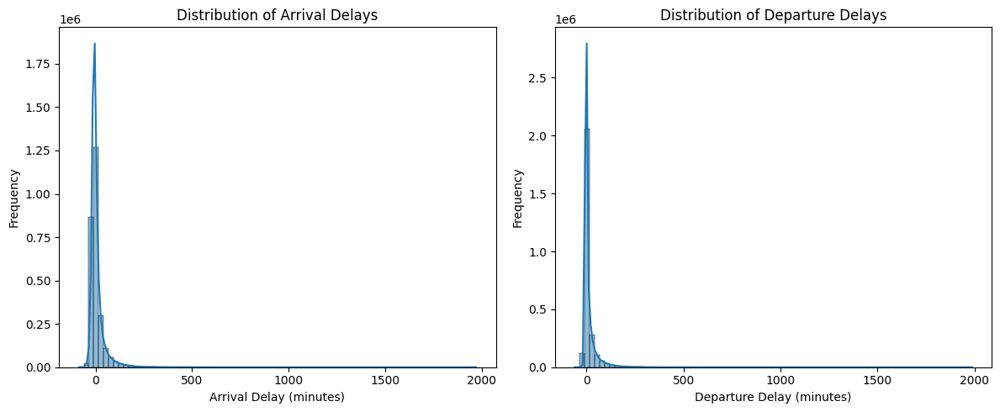

In [0]:
pdf = df_flights.select("ARR_DELAY", "DEP_DELAY").toPandas()

# Arrivial analysis just for fun
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.histplot(pdf["ARR_DELAY"], bins=80, kde=True)
plt.title("Distribution of Arrival Delays")
plt.xlabel("Arrival Delay (minutes)")
plt.ylabel("Frequency")

plt.subplot(1, 2, 2)
sns.histplot(pdf["DEP_DELAY"], bins=80, kde=True)
plt.title("Distribution of Departure Delays")
plt.xlabel("Departure Delay (minutes)")
plt.ylabel("Frequency")

plt.tight_layout()
plt.show()

In [0]:
df_flights.select("DEP_DELAY").describe().show()

+-------+------------------+
|summary|         DEP_DELAY|
+-------+------------------+
|  count|           2722232|
|   mean|10.362709717614075|
| stddev| 37.86481540541773|
|    min|             -61.0|
|    max|            1988.0|
+-------+------------------+



Text(0, 0.5, 'Frequency')

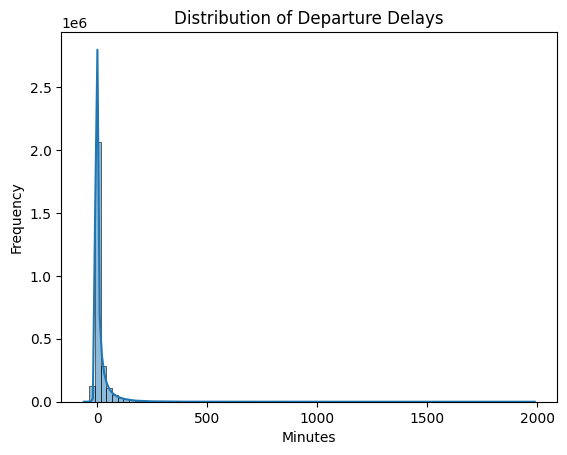

In [0]:
dep_delay_list = (
    df_flights
    .select("DEP_DELAY")
    .rdd
    .flatMap(lambda x: x)
    .collect()
)

sns.histplot(dep_delay_list, bins=80, kde=True)
plt.title("Distribution of Departure Delays")
plt.xlabel("Minutes")
plt.ylabel("Frequency")

OP_UNIQUE_CARRIER,AvgDepDelay
UA,14.265419187554018
NK,14.114123679303916
AA,10.669361093121617
EV,9.87544007293639
B6,14.805093062052272
DL,8.759463995117983
OO,9.540316438415221
F9,20.98568179468624
US,6.650787297909316
MQ,15.556966627710686


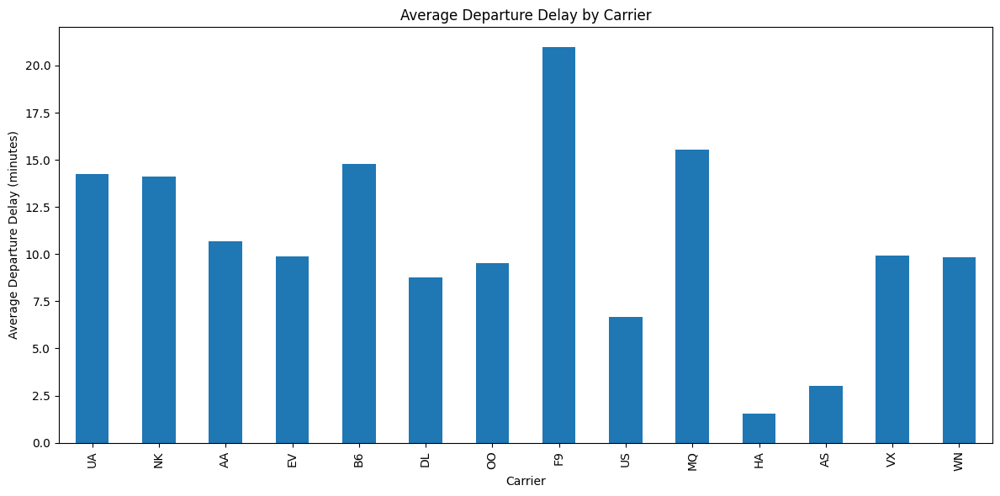

In [0]:
from pyspark.sql.functions import mean

carrier_delay = df_flights.groupBy("OP_UNIQUE_CARRIER").agg(mean("DEP_DELAY").alias("AvgDepDelay"))
display(carrier_delay)

carrier_delay_pd = carrier_delay.toPandas()
carrier_delay_pd.plot.bar(x="OP_UNIQUE_CARRIER", y="AvgDepDelay", figsize=(12,6), legend=False)
plt.title("Average Departure Delay by Carrier")
plt.xlabel("Carrier")
plt.ylabel("Average Departure Delay (minutes)")
plt.tight_layout()
plt.show()

In [0]:
from pyspark.sql.functions import mean, desc

origin_delay = df_flights.groupBy("ORIGIN").agg(mean("DEP_DELAY").alias("AvgDepDelay")).orderBy(desc("AvgDepDelay"))
display(origin_delay)
origin_delay.plot.bar(x="ORIGIN", y="AvgDepDelay")

ORIGIN,AvgDepDelay
TTN,33.344086021505376
ILG,31.59722222222222
PPG,29.296296296296298
BPT,24.2
OTH,23.479166666666668
BGR,21.9
GUM,19.833333333333332
SCE,19.25133689839572
SMX,19.125
CEC,18.80246913580247


DEP_DEL15,count
null,84710
0.0,2166530
1.0,555702


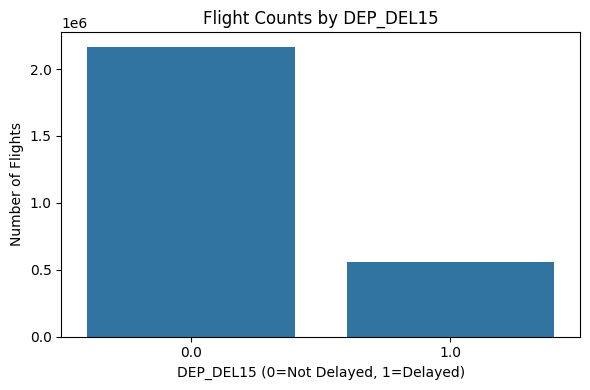

In [0]:
dep_del15_counts = df_flights.groupBy("DEP_DEL15").count().orderBy("DEP_DEL15")
display(dep_del15_counts)

dep_del15_pd = dep_del15_counts.toPandas()
plt.figure(figsize=(6,4))
sns.barplot(x="DEP_DEL15", y="count", data=dep_del15_pd)
plt.title("Flight Counts by DEP_DEL15")
plt.xlabel("DEP_DEL15 (0=Not Delayed, 1=Delayed)")
plt.ylabel("Number of Flights")
plt.tight_layout()
plt.show()

DEP_DELAY,count
null,84710
-61.0,2
-48.0,2
-47.0,2
-42.0,6
-41.0,4
-40.0,10
-39.0,6
-38.0,12
-37.0,14


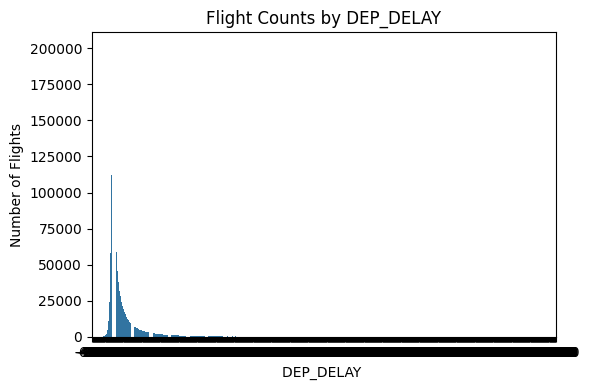

In [0]:
dep_del_counts = df_flights.groupBy("DEP_DELAY").count().orderBy("DEP_DELAY")
display(dep_del_counts)

dep_del_pd = dep_del_counts.toPandas()
plt.figure(figsize=(6,4))
sns.barplot(x="DEP_DELAY", y="count", data=dep_del_pd)
plt.title("Flight Counts by DEP_DELAY")
plt.xlabel("DEP_DELAY ")
plt.ylabel("Number of Flights")
plt.tight_layout()
plt.show()

Is flight id associated with the flight? (for further analysis if possible)


Planned algorithms

Outcome (y) = dep delay time in minutes, where threshold = delay

| algo | loss func |
| ---- | ---- |
| XGBoost | MSE |
|Random forest? | MSE? |
| Linear Regression | MSE|
| Ridge Regression | Ridge reg MSE|
| Lasso Reg | Lasso reg MSE |

<!-- Maybe k-means?
Euclidean loss 
https://wei2624.github.io/MachineLearning/usv_kmeans/

Can help us with identifying clusters of delay components 

Nevermind, reject this idea since it won't help w/ prediction
-->

Metrics
- MSE - standard one
- Mean Absolute Error????
- Regularized MSE (lasso, ridge)



summary,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPrecipitationValue120,ShortDurationPrecipitationValue150,ShortDurationPrecipitationValue180,REM,BackupDirection,BackupDistance,BackupDistanceUnit,BackupElements,BackupElevation,BackupEquipment,BackupLatitude,BackupLongitude,BackupName,WindEquipmentChangeDate,YEAR,HourlyPrecipitationDouble,HourlyVisibilityDouble,HourlyWindSpeedDouble
count,26481620,26481620,26291206,26291206,26291206,26291206,26481620,26481620,16282696,24881421,26093965,3848474,3901523,8376925,8675185,24873959,15935340,10988887,15405990,19818722,15164969,26161444,2187173,26481620,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,26071258,500051,502763,502763,508805,387627,489553,380482,380482,525563,1793152,26481620,3363331,19743318,26481620
mean,5.449546793476492E10,null,37.47637284108368,-29.040975867306543,323.9880193350586,null,null,5.011880963269981,30.05764775476033,30.646839743180145,39.93323905482208,0.008013448572263614,null,0.001527619549437471,4.857030714618766,72.96724354821384,29.520969034163375,30.028670131364986,28.85166140749071,8.46210777691967,34.881729419485566,168.81234620452992,25.720846097175,8.231347742320901,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,n

Columns in df_weather: ['AWND', 'BackupDirection', 'BackupDistance', 'BackupDistanceUnit', 'BackupElements', 'BackupElevation', 'BackupEquipment', 'BackupLatitude', 'BackupLongitude', 'BackupName', 'CDSD', 'CLDD', 'DATE', 'DSNW', 'DailyAverageDewPointTemperature', 'DailyAverageDryBulbTemperature', 'DailyAverageRelativeHumidity', 'DailyAverageSeaLevelPressure', 'DailyAverageStationPressure', 'DailyAverageWetBulbTemperature', 'DailyAverageWindSpeed', 'DailyCoolingDegreeDays', 'DailyDepartureFromNormalAverageTemperature', 'DailyHeatingDegreeDays', 'DailyMaximumDryBulbTemperature', 'DailyMinimumDryBulbTemperature', 'DailyPeakWindDirection', 'DailyPeakWindSpeed', 'DailyPrecipitation', 'DailySnowDepth', 'DailySnowfall', 'DailySustainedWindDirection', 'DailySustainedWindSpeed', 'DailyWeather', 'ELEVATION', 'HDSD', 'HTDD', 'HourlyAltimeterSetting', 'HourlyDewPointTemperature', 'HourlyDryBulbTemperature', 'HourlyPrecipitation', 'HourlyPrecipitationDouble', 'HourlyPresentWeatherType', 'HourlyPre

column,missing_count
STATION,0
DATE,0
LATITUDE,190414
LONGITUDE,190414
ELEVATION,190414
NAME,190414
REPORT_TYPE,0
SOURCE,0
HourlyAltimeterSetting,10198924
HourlyDewPointTemperature,1600199


weather
Total rows: 26481620
Distinct rows: 26481620
Duplicate rows: 0
No duplicates found.


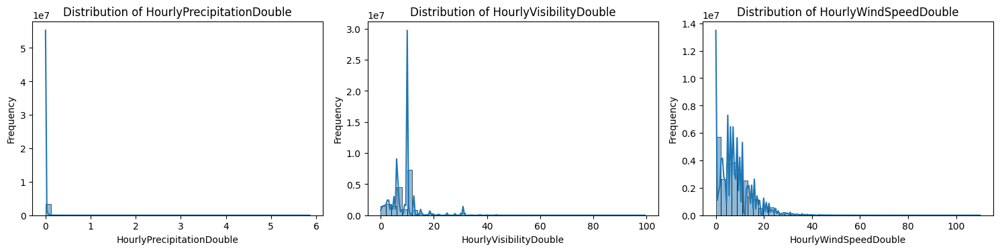

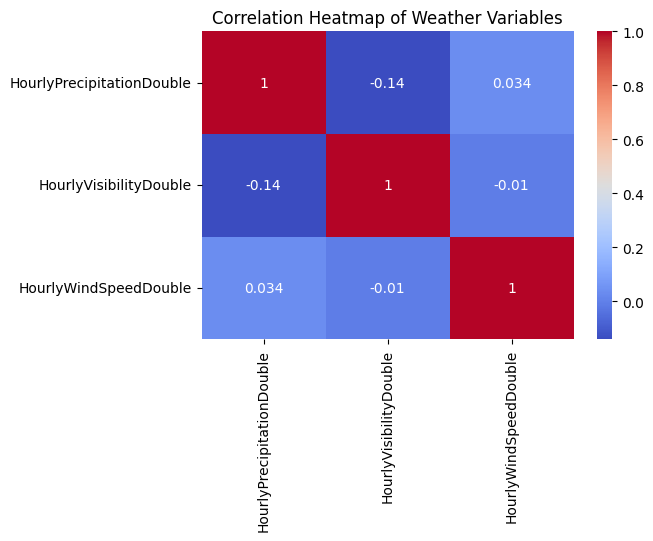

In [0]:
# Summary statistics for weather data
display(df_weather.describe())

# List columns in weather data
print("Columns in df_weather:", sorted(df_weather.columns))

# Check missing values in weather data
check_missing(df_weather, "weather")

# Check for duplicates in weather data
check_duplicates(df_weather, "weather")

# Boxplots for key weather variables
weather_cols = ['HourlyPrecipitationDouble', 'HourlyVisibilityDouble', 'HourlyWindSpeedDouble']
weather_data = df_weather.select(*weather_cols).toPandas()

# Histograms for weather variables
plt.figure(figsize=(15, 4))
for i, col in enumerate(weather_cols):
    plt.subplot(1, 3, i+1)
    sns.histplot(weather_data[col].dropna(), bins=50, kde=True)
    plt.title(f"Distribution of {col}")
    plt.xlabel(col)
    plt.ylabel("Frequency")
plt.tight_layout()
plt.show()

# Correlation heatmap for weather variables
corr = weather_data.corr()
plt.figure(figsize=(6,4))
sns.heatmap(corr, annot=True, cmap="coolwarm")
plt.title("Correlation Heatmap of Weather Variables")
plt.show()

In [0]:
# Summary statistics for station data
display(df_stations.describe())

# List columns in station data
print("Columns in df_stations:", sorted(df_stations.columns))

# Check missing values in station data
check_missing(df_stations, "stations")

# Check for duplicates in station data
check_duplicates(df_stations, "stations")

# Select numeric columns for visualization
numeric_cols = [field.name for field in df_stations.schema.fields if str(field.dataType) in ['IntegerType', 'DoubleType', 'FloatType', 'LongType', 'ShortType']]
station_data = df_stations.select(*numeric_cols).toPandas()

if len(numeric_cols) > 0:
    # Boxplots for key numeric variables
    plt.figure(figsize=(10, 6))
    station_data.boxplot(column=numeric_cols)
    plt.title('Boxplots of Station Numeric Variables')
    plt.xlabel('Station Variables')
    plt.ylabel('Values')
    plt.xticks(rotation=45)
    plt.show()

    # Histograms for numeric variables
    plt.figure(figsize=(15, 4))
    for i, col in enumerate(numeric_cols):
        plt.subplot(1, len(numeric_cols), i+1)
        sns.histplot(station_data[col].dropna(), bins=50, kde=True)
        plt.title(f"Distribution of {col}")
        plt.xlabel(col)
        plt.ylabel("Frequency")
    plt.tight_layout()
    plt.show()

    # Correlation heatmap for numeric variables
    corr = station_data.corr()
    plt.figure(figsize=(6,4))
    sns.heatmap(corr, annot=True, cmap="coolwarm")
    plt.title("Correlation Heatmap of Station Numeric Variables")
    plt.show()
else:
    print("No numeric columns found in df_stations for visualization.")

summary,usaf,wban,station_id,lat,lon,neighbor_id,neighbor_name,neighbor_state,neighbor_call,neighbor_lat,neighbor_lon,distance_to_neighbor
count,5004169,5004169,5004169,5004169,5004169,5004169,5004169,5004169,5004169,5004169,5004169,5004169
mean,724806.8676069154,32518.517210549842,7.248071938593896E10,39.835810907459745,-98.71206392527364,7.248071938593904E10,null,null,null,39.835810907559264,-98.712063925185,1343.5152928146138
stddev,17516.71784984958,33231.79213586726,1.7516719941555257E9,8.60217185277331,22.1522224995772,1.7516719941555448E9,null,null,null,8.602171852773315,22.152222499577082,948.8454195513905
min,690020,00102,69002093218,17.7,-176.65,69002093218,A L MANGHAM JR RGNL ARPT,AK,4DG,17.7,-176.65,0.0
max,A51256,96402,A5125600451,71.333,174.1,A5125600451,ZEPHYRHILLS MUNICIPAL AIRPORT,WY,TSG,71.333,174.1,6435.969681007664


Columns in df_stations: ['distance_to_neighbor', 'lat', 'lon', 'neighbor_call', 'neighbor_id', 'neighbor_lat', 'neighbor_lon', 'neighbor_name', 'neighbor_state', 'station_id', 'usaf', 'wban']
stations


column,missing_count
usaf,0
wban,0
station_id,0
lat,0
lon,0
neighbor_id,0
neighbor_name,0
neighbor_state,0
neighbor_call,0
neighbor_lat,0


stations
Total rows: 5004169
Distinct rows: 5004169
Duplicate rows: 0
No duplicates found.
No numeric columns found in df_stations for visualization.


In [0]:
# Summary statistics for otpw data
display(df_otpw.describe())

# List columns in otpw data
print("Columns in df_otpw:", sorted(df_otpw.columns))

# Check missing values in otpw data
check_missing(df_otpw, "otpw")

# Check for duplicates in otpw data
check_duplicates(df_otpw, "otpw")

# Select numeric columns for visualization
numeric_cols_otpw = [field.name for field in df_otpw.schema.fields if str(field.dataType) in ['IntegerType', 'DoubleType', 'FloatType', 'LongType', 'ShortType']]
otpw_data = df_otpw.select(*numeric_cols_otpw).toPandas()

if len(numeric_cols_otpw) > 0:
    # Boxplots for key numeric variables
    plt.figure(figsize=(10, 6))
    otpw_data.boxplot(column=numeric_cols_otpw)
    plt.title('Boxplots of OTPW Numeric Variables')
    plt.xlabel('OTPW Variables')
    plt.ylabel('Values')
    plt.xticks(rotation=45)
    plt.show()

    # Histograms for numeric variables
    plt.figure(figsize=(15, 4))
    for i, col in enumerate(numeric_cols_otpw):
        plt.subplot(1, len(numeric_cols_otpw), i+1)
        sns.histplot(otpw_data[col].dropna(), bins=50, kde=True)
        plt.title(f"Distribution of {col}")
        plt.xlabel(col)
        plt.ylabel("Frequency")
    plt.tight_layout()
    plt.show()

    # Correlation heatmap for numeric variables
    corr_otpw = otpw_data.corr()
    plt.figure(figsize=(6,4))
    sns.heatmap(corr_otpw, annot=True, cmap="coolwarm")
    plt.title("Correlation Heatmap of OTPW Numeric Variables")
    plt.show()
else:
    print("No numeric columns found in df_otpw for visualization.")

summary,QUARTER,DAY_OF_MONTH,DAY_OF_WEEK,FL_DATE,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,ORIGIN_STATE_ABR,ORIGIN_STATE_FIPS,ORIGIN_STATE_NM,ORIGIN_WAC,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEST_STATE_ABR,DEST_STATE_FIPS,DEST_STATE_NM,DEST_WAC,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,DEP_DELAY_NEW,DEP_DEL15,DEP_DELAY_GROUP,DEP_TIME_BLK,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,ARR_DELAY_NEW,ARR_DEL15,ARR_DELAY_GROUP,ARR_TIME_BLK,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ACTUAL_ELAPSED_TIME,AIR_TIME,FLIGHTS,DISTANCE,DISTANCE_GROUP,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,FIRST_DEP_TIME,TOTAL_ADD_GTIME,LONGEST_ADD_GTIME,YEAR,MONTH,origin_airport_name,origin_station_name,origin_station_id,origin_iata_code,origin_icao,origin_type,origin_region,origin_station_lat,origin_station_lon,origin_airport_lat,origin_airport_lon,origin_station_dis,dest_airport_name,dest_station_name,dest_station_id,dest_iata_code,dest_icao,dest_type,dest_region,dest_station_lat,dest_station_lon,dest_airport_lat,dest_airport_lon,dest_station_dis,sched_depart_date_time,sched_depart_date_time_UTC,four_hours_prior_depart_UTC,two_hours_prior_depart_UTC,STATION,DATE,LATITUDE,LONGITUDE,ELEVATION,NAME,REPORT_TYPE,SOURCE,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPrecipitation,HourlyPresentWeatherType,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySkyConditions,HourlySeaLevelPressure,HourlyStationPressure,HourlyVisibility,HourlyWetBulbTemperature,HourlyWindDirection,HourlyWindGustSpeed,HourlyWindSpeed,Sunrise,Sunset,DailyAverageDewPointTemperature,DailyAverageDryBulbTemperature,DailyAverageRelativeHumidity,DailyAverageSeaLevelPressure,DailyAverageStationPressure,DailyAverageWetBulbTemperature,DailyAverageWindSpeed,DailyCoolingDegreeDays,DailyDepartureFromNormalAverageTemperature,DailyHeatingDegreeDays,DailyMaximumDryBulbTemperature,DailyMinimumDryBulbTemperature,DailyPeakWindDirection,DailyPeakWindSpeed,DailyPrecipitation,DailySnowDepth,DailySnowfall,DailySustainedWindDirection,DailySustainedWindSpeed,DailyWeather,MonthlyAverageRH,MonthlyDaysWithGT001Precip,MonthlyDaysWithGT010Precip,MonthlyDaysWithGT32Temp,MonthlyDaysWithGT90Temp,MonthlyDaysWithLT0Temp,MonthlyDaysWithLT32Temp,MonthlyDepartureFromNormalAverageTemperature,MonthlyDepartureFromNormalCoolingDegreeDays,MonthlyDepartureFromNormalHeatingDegreeDays,MonthlyDepartureFromNormalMaximumTemperature,MonthlyDepartureFromNormalMinimumTemperature,MonthlyDepartureFromNormalPrecipitation,MonthlyDewpointTemperature,MonthlyGreatestPrecip,MonthlyGreatestPrecipDate,MonthlyGreatestSnowDepth,MonthlyGreatestSnowDepthDate,MonthlyGreatestSnowfall,MonthlyGreatestSnowfallDate,MonthlyMaxSeaLevelPressureValue,MonthlyMaxSeaLevelPressureValueDate,MonthlyMaxSeaLevelPressureValueTime,MonthlyMaximumTemperature,MonthlyMeanTemperature,MonthlyMinSeaLevelPressureValue,MonthlyMinSeaLevelPressureValueDate,MonthlyMinSeaLevelPressureValueTime,MonthlyMinimumTemperature,MonthlySeaLevelPressure,MonthlyStationPressure,MonthlyTotalLiquidPrecipitation,MonthlyTotalSnowfall,MonthlyWetBulb,AWND,CDSD,CLDD,DSNW,HDSD,HTDD,NormalsCoolingDegreeDay,NormalsHeatingDegreeDay,ShortDurationEndDate005,ShortDurationEndDate010,ShortDurationEndDate015,ShortDurationEndDate020,ShortDurationEndDate030,ShortDurationEndDate045,ShortDurationEndDate060,ShortDurationEndDate080,ShortDurationEndDate100,ShortDurationEndDate120,ShortDurationEndDate150,ShortDurationEndDate180,ShortDurationPrecipitationValue005,ShortDurationPrecipitationValue010,ShortDurationPrecipitationValue015,ShortDurationPrecipitationValue020,ShortDurationPrecipitationValue030,ShortDurationPrecipitationValue045,ShortDurationPrecipitationValue060,ShortDurationPrecipitationValue080,ShortDurationPrecipitationValue100,ShortDurationPr

Columns in df_otpw: ['ACTUAL_ELAPSED_TIME', 'AIR_TIME', 'ARR_DEL15', 'ARR_DELAY', 'ARR_DELAY_GROUP', 'ARR_DELAY_NEW', 'ARR_TIME', 'ARR_TIME_BLK', 'AWND', 'BackupDirection', 'BackupDistance', 'BackupDistanceUnit', 'BackupElements', 'BackupElevation', 'BackupEquipment', 'BackupLatitude', 'BackupLongitude', 'BackupName', 'CANCELLATION_CODE', 'CANCELLED', 'CARRIER_DELAY', 'CDSD', 'CLDD', 'CRS_ARR_TIME', 'CRS_DEP_TIME', 'CRS_ELAPSED_TIME', 'DATE', 'DAY_OF_MONTH', 'DAY_OF_WEEK', 'DEP_DEL15', 'DEP_DELAY', 'DEP_DELAY_GROUP', 'DEP_DELAY_NEW', 'DEP_TIME', 'DEP_TIME_BLK', 'DEST', 'DEST_AIRPORT_ID', 'DEST_AIRPORT_SEQ_ID', 'DEST_CITY_MARKET_ID', 'DEST_CITY_NAME', 'DEST_STATE_ABR', 'DEST_STATE_FIPS', 'DEST_STATE_NM', 'DEST_WAC', 'DISTANCE', 'DISTANCE_GROUP', 'DIVERTED', 'DSNW', 'DailyAverageDewPointTemperature', 'DailyAverageDryBulbTemperature', 'DailyAverageRelativeHumidity', 'DailyAverageSeaLevelPressure', 'DailyAverageStationPressure', 'DailyAverageWetBulbTemperature', 'DailyAverageWindSpeed', 'D

column,missing_count
QUARTER,0
DAY_OF_MONTH,0
DAY_OF_WEEK,0
FL_DATE,0
OP_UNIQUE_CARRIER,0
OP_CARRIER_AIRLINE_ID,0
OP_CARRIER,0
TAIL_NUM,8187
OP_CARRIER_FL_NUM,0
ORIGIN_AIRPORT_ID,0


otpw
Total rows: 1401363
Distinct rows: 1401363
Duplicate rows: 0
No duplicates found.
No numeric columns found in df_otpw for visualization.
